In [43]:
!pip install sweetviz

^C


In [1]:
import pandas as pd # cargar y manipular datos
import sweetviz as sv # herramienta de análisis exploratória
import numpy as np

c:\Users\oscar\AppData\Local\Programs\Python\Python310\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Reflection Attacks-TCP/UDP-DNS

In [6]:
DNS = pd.read_csv("01-12/DrDos_DNS.csv")

C:\Users\oscar\AppData\Local\Temp\ipykernel_13956\2539068651.py:1: DtypeWarning: Columns (85) have mixed types. Specify dtype option on import or set low_memory=False.
  DNS = pd.read_csv("01-12/DrDos_DNS.csv")


In [7]:
DNS.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5074413 entries, 0 to 5074412
Data columns (total 88 columns):
 #   Column                        Dtype  
---  ------                        -----  
 0   Unnamed: 0                    int64  
 1   Flow ID                       object 
 2    Source IP                    object 
 3    Source Port                  int64  
 4    Destination IP               object 
 5    Destination Port             int64  
 6    Protocol                     int64  
 7    Timestamp                    object 
 8    Flow Duration                int64  
 9    Total Fwd Packets            int64  
 10   Total Backward Packets       int64  
 11  Total Length of Fwd Packets   float64
 12   Total Length of Bwd Packets  float64
 13   Fwd Packet Length Max        float64
 14   Fwd Packet Length Min        float64
 15   Fwd Packet Length Mean       float64
 16   Fwd Packet Length Std        float64
 17  Bwd Packet Length Max         float64
 18   Bwd Packet Length Min

In [8]:
DNS.describe().T

,count,mean,std,min,25%,50%,75%,max
Unnamed: 0,5074413.0,13800.644683,8020.386059,0.0,6844.0,13776.0,20741.0,2.818200e+04
Source Port,5074413.0,800.096216,1851.189445,0.0,581.0,727.0,875.0,6.550800e+04
Destination Port,5074413.0,32792.122832,18924.779246,0.0,16430.0,32794.0,49183.0,6.553500e+04
Protocol,5074413.0,16.991417,0.319400,0.0,17.0,17.0,17.0,1.700000e+01
Flow Duration,5074413.0,7176.139769,771184.516828,0.0,1.0,1.0,2.0,1.200000e+08
...,...,...,...,...,...,...,...,...
Idle Mean,5074413.0,2331.790909,331818.837897,0.0,0.0,0.0,0.0,1.017888e+08
Idle Std,5074413.0,105.435488,45717.812613,0.0,0.0,0.0,0.0,6.600292e+07
Idle Max,5074413.0,2420.004081,343415.949997,0.0,0.0,0.0,0.0,1.037700e+08
Idle Min,5074413.0,2240.775522,324293.442153,0.0,0.0,0.0,0.0,1.017888e+08


In [9]:
for column_name in DNS.select_dtypes(include=["object_"]):
    print(column_name, "->", DNS[column_name].unique(), "\n")

Flow ID -> ['172.16.0.5-192.168.50.1-634-60495-17'
 '172.16.0.5-192.168.50.1-60495-634-17'
 '172.16.0.5-192.168.50.1-634-46391-17' ...
 '172.16.0.5-192.168.50.1-900-14341-17'
 '172.16.0.5-192.168.50.1-900-46229-17'
 '172.16.0.5-192.168.50.1-900-23895-17'] 

 Source IP -> ['172.16.0.5' '192.168.50.1' '192.168.50.8' '192.168.50.253'
 '192.168.50.254' '54.210.144.213' '8.6.0.1' '34.208.208.167'
 '192.168.50.6' '74.208.236.171' '172.217.10.2' '172.217.12.162'
 '172.217.12.134' '54.218.239.186' '52.203.113.92' '35.173.44.140'
 '23.194.142.213' '54.222.199.48' '192.168.50.7' '23.15.4.11'
 '104.36.115.113' '172.217.0.110' '72.21.91.29' '208.185.50.75'
 '34.216.156.21' '208.185.50.80' '34.204.21.102' '52.7.108.194'
 '108.177.112.108' '172.217.0.97' '172.217.0.102' '172.217.0.99'
 '172.217.2.98' '172.217.1.4' '172.217.2.170' '172.217.1.2' '172.217.0.98'
 '173.241.244.143' '38.69.238.16' '172.217.10.14' '125.56.201.115'
 '52.89.179.237' '0.0.0.0' '172.217.7.6' '172.217.10.66' '172.217.12.129'
 '

In [10]:
DNS.isna().values.any()

True

In [21]:
DNSCopia= DNS
DNSCopia.isna().sum()

Unnamed: 0         0
Flow ID            0
 Source IP         0
 Source Port       0
 Destination IP    0
                  ..
 Idle Max          0
 Idle Min          0
SimillarHTTP       0
 Inbound           0
 Label             0
Length: 88, dtype: int64

In [22]:
import numpy as np
DNSCopia['SimillarHTTP'] = DNSCopia["SimillarHTTP"].replace([0], "")

In [23]:
for column_name in DNSCopia.select_dtypes(include=["object_"]):
    print(column_name, "->", DNSCopia[column_name].unique(), "\n")

Flow ID -> ['172.16.0.5-192.168.50.1-634-60495-17'
 '172.16.0.5-192.168.50.1-60495-634-17'
 '172.16.0.5-192.168.50.1-634-46391-17' ...
 '172.16.0.5-192.168.50.1-900-14341-17'
 '172.16.0.5-192.168.50.1-900-46229-17'
 '172.16.0.5-192.168.50.1-900-23895-17'] 

 Source IP -> ['172.16.0.5' '192.168.50.1' '192.168.50.8' '192.168.50.253'
 '192.168.50.254' '54.210.144.213' '8.6.0.1' '34.208.208.167'
 '192.168.50.6' '74.208.236.171' '172.217.10.2' '172.217.12.162'
 '172.217.12.134' '54.218.239.186' '52.203.113.92' '35.173.44.140'
 '23.194.142.213' '54.222.199.48' '192.168.50.7' '23.15.4.11'
 '104.36.115.113' '172.217.0.110' '72.21.91.29' '208.185.50.75'
 '34.216.156.21' '208.185.50.80' '34.204.21.102' '52.7.108.194'
 '108.177.112.108' '172.217.0.97' '172.217.0.102' '172.217.0.99'
 '172.217.2.98' '172.217.1.4' '172.217.2.170' '172.217.1.2' '172.217.0.98'
 '173.241.244.143' '38.69.238.16' '172.217.10.14' '125.56.201.115'
 '52.89.179.237' '0.0.0.0' '172.217.7.6' '172.217.10.66' '172.217.12.129'
 '

In [24]:
DNSCopia = DNSCopia.replace([np.inf, -np.inf], np.nan)

In [25]:
DNSCopia=DNSCopia.dropna()

In [26]:
DNSCopia.isna().values.any()

False

Done! Use 'show' commands to display/save.   |██████████| [100%]   00:06 -> (00:00 left)    



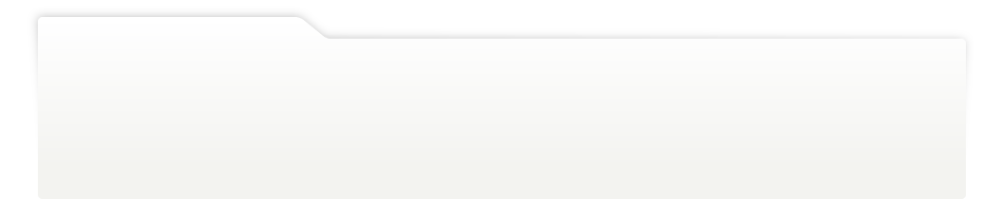
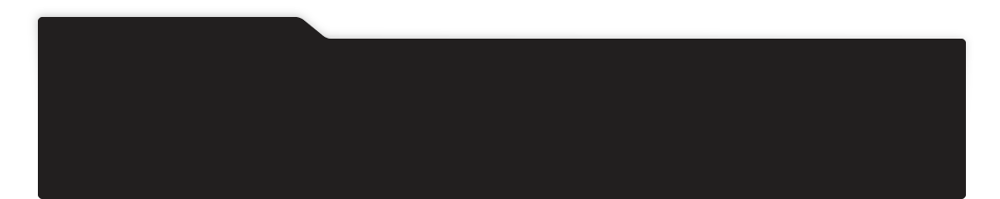
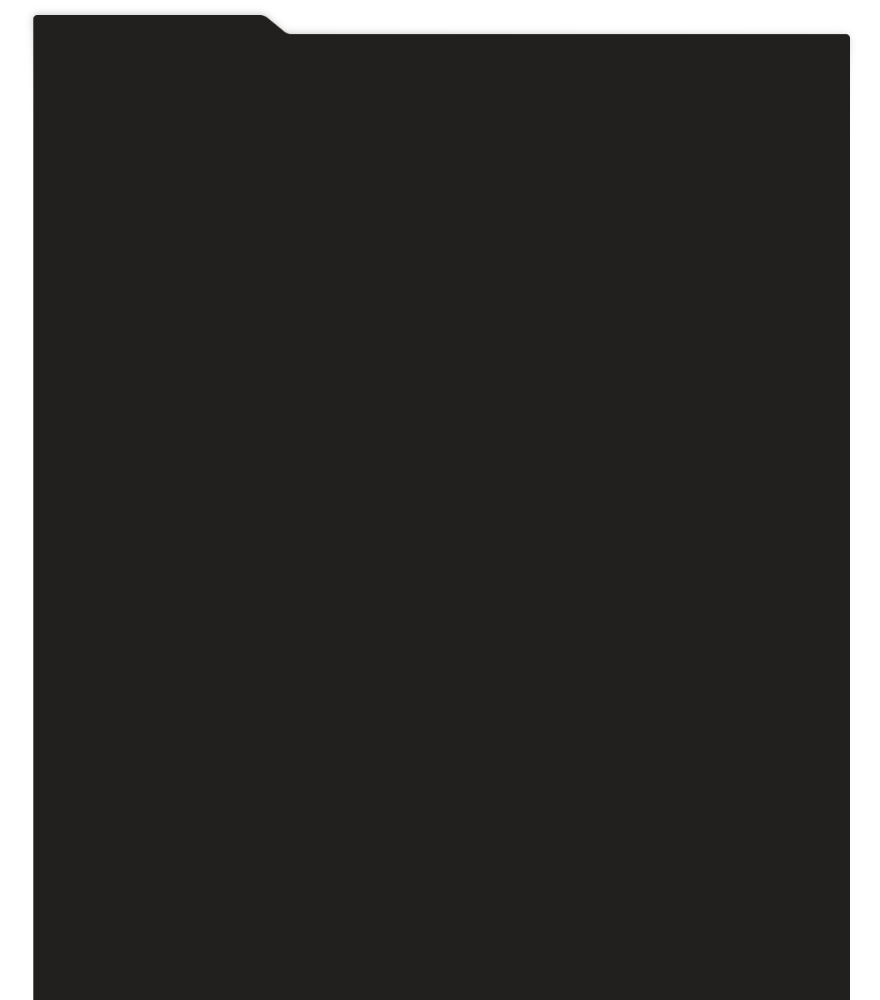
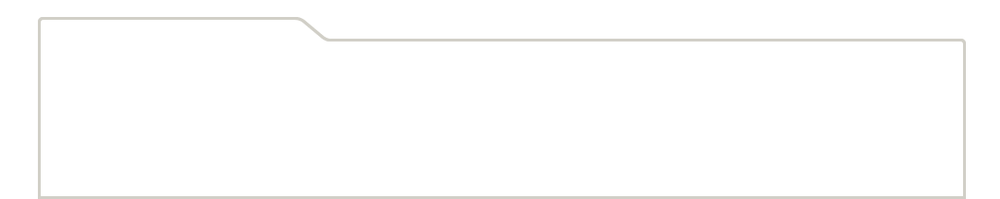
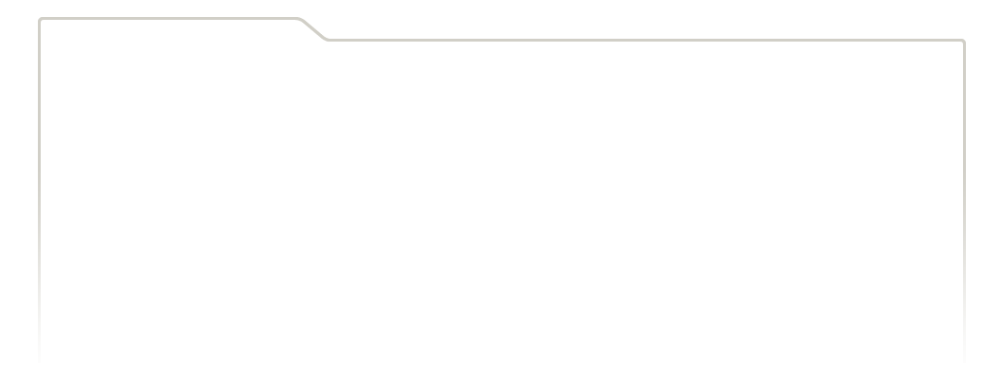
...
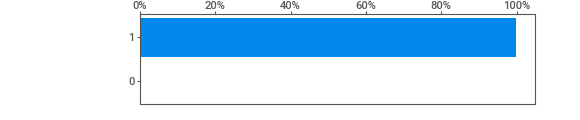
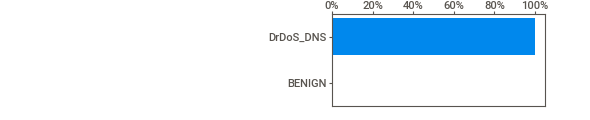
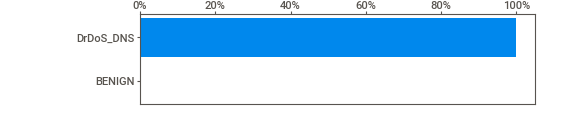
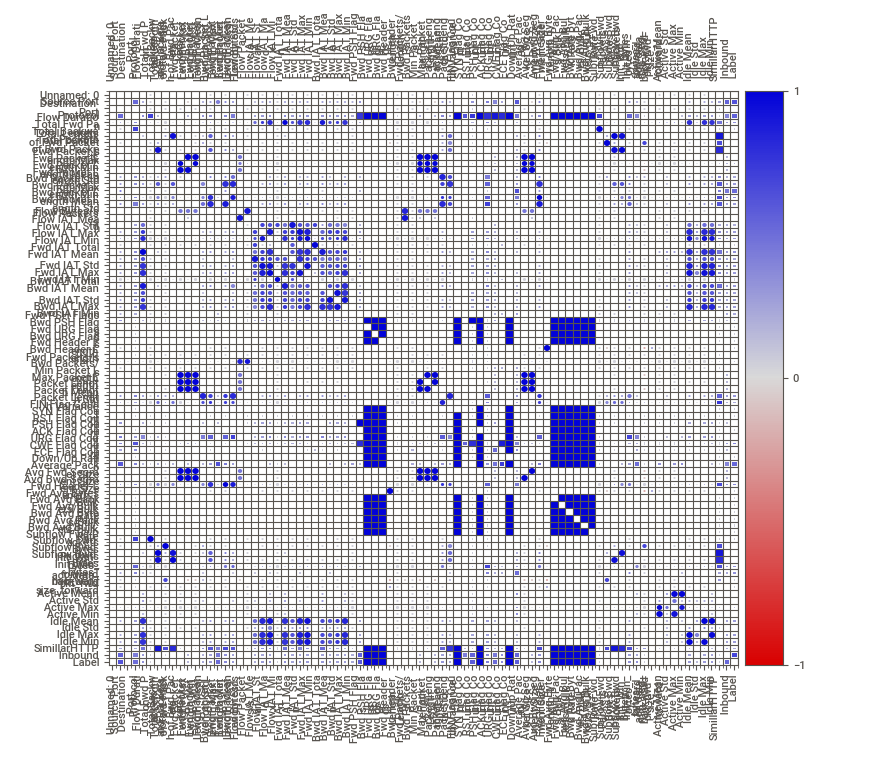
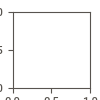

In [18]:
reportDNS = sv.analyze(DNSCopia)
reportDNS.show_notebook() 

In [19]:
reportDNS.show_html()

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [27]:
DNSCopia.to_csv('DrDoS_DNS_C.csv', sep=',')

## Reflection Attacks-TCP/UDP-LDAP

In [2]:
LDAP = pd.read_csv("01-12/DrDoS_LDAP.csv")

C:\Users\oscar\AppData\Local\Temp\ipykernel_10752\612785388.py:1: DtypeWarning: Columns (85) have mixed types. Specify dtype option on import or set low_memory=False.
  LDAP = pd.read_csv("01-12/DrDoS_LDAP.csv")


In [3]:
LDAP.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2181542 entries, 0 to 2181541
Data columns (total 88 columns):
 #   Column                        Dtype  
---  ------                        -----  
 0   Unnamed: 0                    int64  
 1   Flow ID                       object 
 2    Source IP                    object 
 3    Source Port                  int64  
 4    Destination IP               object 
 5    Destination Port             int64  
 6    Protocol                     int64  
 7    Timestamp                    object 
 8    Flow Duration                int64  
 9    Total Fwd Packets            int64  
 10   Total Backward Packets       int64  
 11  Total Length of Fwd Packets   float64
 12   Total Length of Bwd Packets  float64
 13   Fwd Packet Length Max        float64
 14   Fwd Packet Length Min        float64
 15   Fwd Packet Length Mean       float64
 16   Fwd Packet Length Std        float64
 17  Bwd Packet Length Max         float64
 18   Bwd Packet Length Min

In [4]:
LDAP.describe().T

,count,mean,std,min,25%,50%,75%,max
Unnamed: 0,2181542.0,17042.828440,9840.008954,0.0,8521.0,17043.0,25564.0,34203.0
Source Port,2181542.0,853.110964,1947.001380,0.0,661.0,811.0,900.0,65510.0
Destination Port,2181542.0,32769.722235,18923.835830,0.0,16400.0,32772.0,49159.0,65535.0
Protocol,2181542.0,16.991318,0.324206,0.0,17.0,17.0,17.0,17.0
Flow Duration,2181542.0,669.880425,64481.564116,0.0,1.0,1.0,2.0,11166178.0
...,...,...,...,...,...,...,...,...
Idle Mean,2181542.0,36.134629,15655.321357,0.0,0.0,0.0,0.0,9258158.0
Idle Std,2181542.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0
Idle Max,2181542.0,36.134629,15655.321357,0.0,0.0,0.0,0.0,9258158.0
Idle Min,2181542.0,36.134629,15655.321357,0.0,0.0,0.0,0.0,9258158.0


In [5]:
for column_name in LDAP.select_dtypes(include=["object_"]):
    print(column_name, "->", LDAP[column_name].unique(), "\n")

Flow ID -> ['172.16.0.5-192.168.50.1-0-0-0' '172.16.0.5-192.168.50.1-900-1808-17'
 '172.16.0.5-192.168.50.1-900-58766-17' ...
 '172.16.0.5-192.168.50.1-847-1622-17'
 '172.16.0.5-192.168.50.1-848-16197-17'
 '172.16.0.5-192.168.50.1-849-7758-17'] 

 Source IP -> ['172.16.0.5' '192.168.50.1' '192.168.50.6' '192.168.50.253' '8.6.0.1'
 '192.168.50.254' '192.168.50.8' '172.217.10.34' '172.217.12.129'
 '125.56.201.105' '192.168.50.7' '173.194.68.108' '52.35.236.192'
 '74.208.236.171' '172.217.11.36' '172.217.11.38' '172.217.10.226'
 '54.192.49.17' '54.192.49.120' '172.217.6.194' '172.217.10.10'
 '172.217.7.3' '172.217.10.106' '192.0.73.2' '4.2.2.4' '52.7.108.194'
 '52.73.38.228' '35.164.138.68' '23.194.142.15' '172.217.11.34'
 '52.35.215.194' '0.0.0.0' '38.69.238.19' '162.248.19.151' '72.21.91.29'
 '172.217.10.110' '35.166.184.180' '209.85.232.108' '172.217.11.42'
 '172.217.10.1' '23.194.142.213' '172.217.7.6' '216.58.219.196'
 '40.124.45.19' '8.8.8.8' '104.88.90.6' '172.217.3.98' '209.85.201

In [7]:
LDAP.isna().values.any()

True

In [8]:
LDAPCopia= LDAP
LDAPCopia.isna().sum()

Unnamed: 0         0
Flow ID            0
 Source IP         0
 Source Port       0
 Destination IP    0
                  ..
 Idle Max          0
 Idle Min          0
SimillarHTTP       0
 Inbound           0
 Label             0
Length: 88, dtype: int64

In [10]:
LDAPCopia['SimillarHTTP'] = LDAPCopia["SimillarHTTP"].replace([0], "")

In [12]:
for column_name in LDAPCopia.select_dtypes(include=["object_"]):
    print(column_name, "->", LDAPCopia[column_name].unique(), "\n")

Flow ID -> ['172.16.0.5-192.168.50.1-0-0-0' '172.16.0.5-192.168.50.1-900-1808-17'
 '172.16.0.5-192.168.50.1-900-58766-17' ...
 '172.16.0.5-192.168.50.1-847-1622-17'
 '172.16.0.5-192.168.50.1-848-16197-17'
 '172.16.0.5-192.168.50.1-849-7758-17'] 

 Source IP -> ['172.16.0.5' '192.168.50.1' '192.168.50.6' '192.168.50.253' '8.6.0.1'
 '192.168.50.254' '192.168.50.8' '172.217.10.34' '172.217.12.129'
 '125.56.201.105' '192.168.50.7' '173.194.68.108' '52.35.236.192'
 '74.208.236.171' '172.217.11.36' '172.217.11.38' '172.217.10.226'
 '54.192.49.17' '54.192.49.120' '172.217.6.194' '172.217.10.10'
 '172.217.7.3' '172.217.10.106' '192.0.73.2' '4.2.2.4' '52.7.108.194'
 '52.73.38.228' '35.164.138.68' '23.194.142.15' '172.217.11.34'
 '52.35.215.194' '0.0.0.0' '38.69.238.19' '162.248.19.151' '72.21.91.29'
 '172.217.10.110' '35.166.184.180' '209.85.232.108' '172.217.11.42'
 '172.217.10.1' '23.194.142.213' '172.217.7.6' '216.58.219.196'
 '40.124.45.19' '8.8.8.8' '104.88.90.6' '172.217.3.98' '209.85.201

In [13]:
import numpy as np
LDAPCopia = LDAPCopia.replace([np.inf, -np.inf], np.nan)

In [14]:
LDAPCopia=LDAPCopia.dropna()

In [15]:
LDAPCopia.isna().values.any()

False

Done! Use 'show' commands to display/save.   |██████████| [100%]   00:10 -> (00:00 left)  



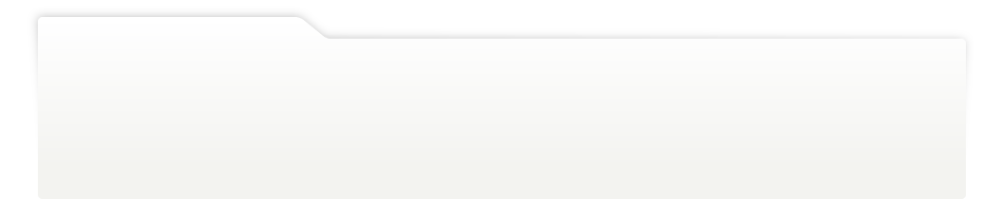
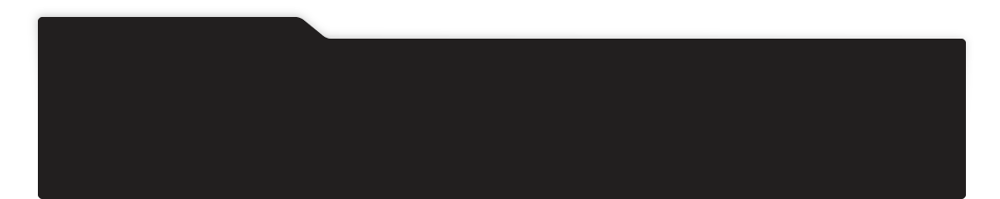
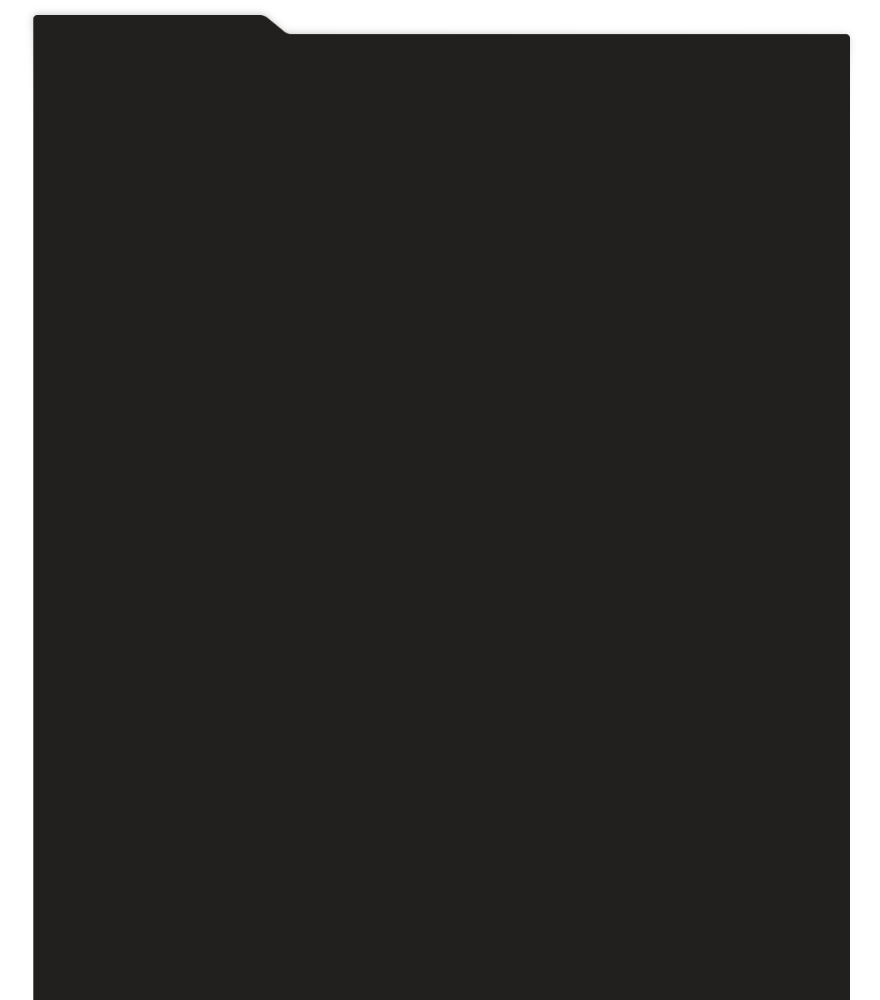
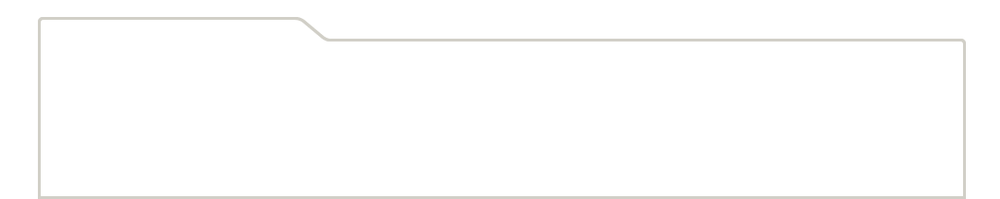
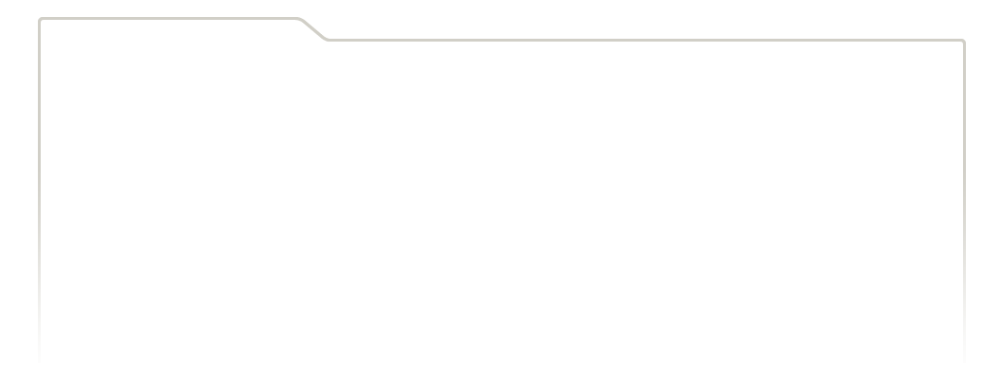
...
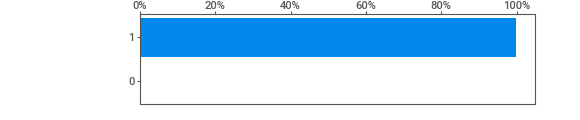
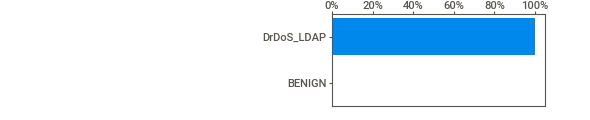
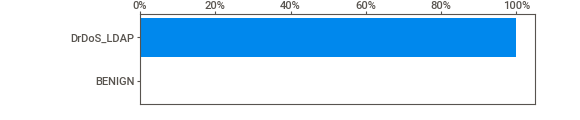
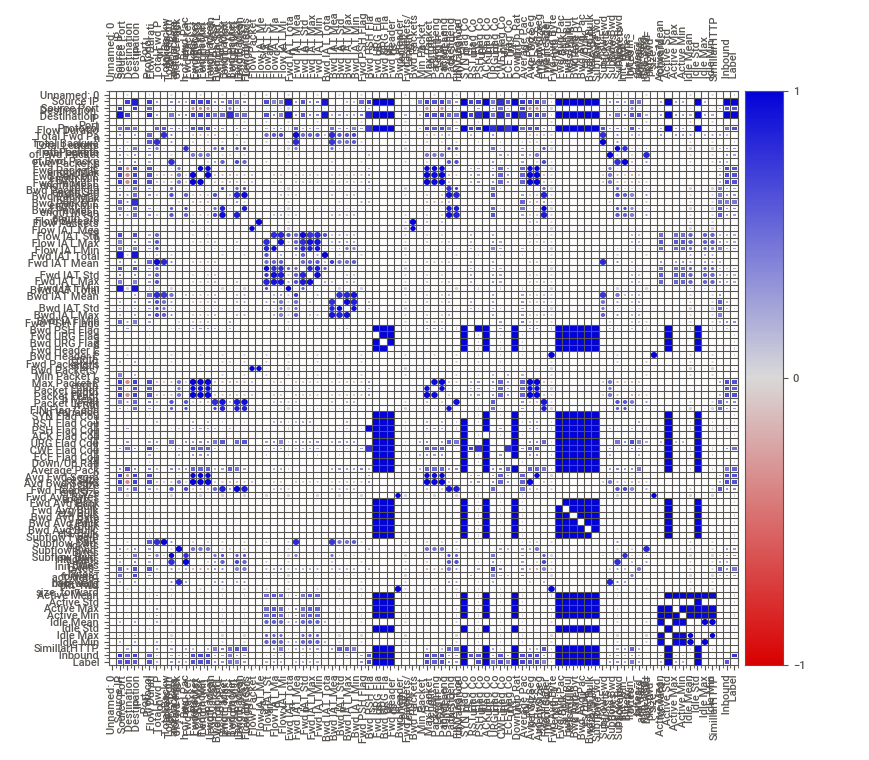
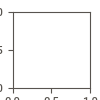

In [17]:
reportLDAP = sv.analyze(LDAPCopia)
reportLDAP.show_notebook()

In [19]:
reportLDAP.show_html()

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [33]:
LDAPCopia.to_csv('csv/DrDoS_LDAP_C.csv', sep=',')

## Reflection Attacks-TCP-MSSQL

In [21]:
MSSQL = pd.read_csv("01-12/DrDos_MSSQL.csv")

C:\Users\oscar\AppData\Local\Temp\ipykernel_10752\2641503299.py:1: DtypeWarning: Columns (85) have mixed types. Specify dtype option on import or set low_memory=False.
  MSSQL = pd.read_csv("01-12/DrDos_MSSQL.csv")


In [22]:
MSSQLCopia= MSSQL
MSSQLCopia.isna().sum()

Unnamed: 0         0
Flow ID            0
 Source IP         0
 Source Port       0
 Destination IP    0
                  ..
 Idle Max          0
 Idle Min          0
SimillarHTTP       0
 Inbound           0
 Label             0
Length: 88, dtype: int64

In [23]:
MSSQLCopia['SimillarHTTP'] = MSSQLCopia["SimillarHTTP"].replace([0], "")

In [24]:
MSSQLCopia = MSSQLCopia.replace([np.inf, -np.inf], np.nan)

In [25]:
MSSQLCopia=MSSQLCopia.dropna()

In [26]:
MSSQLCopia.isna().values.any()

False

Done! Use 'show' commands to display/save.   |██████████| [100%]   00:08 -> (00:00 left)    



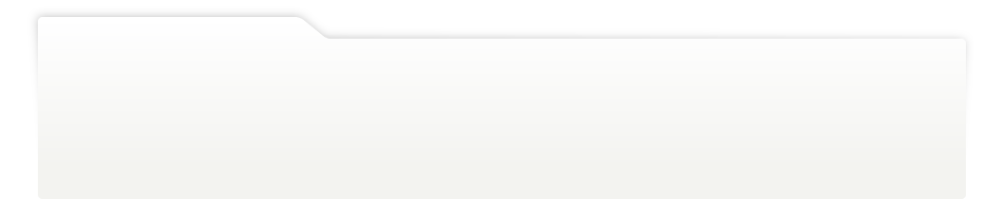
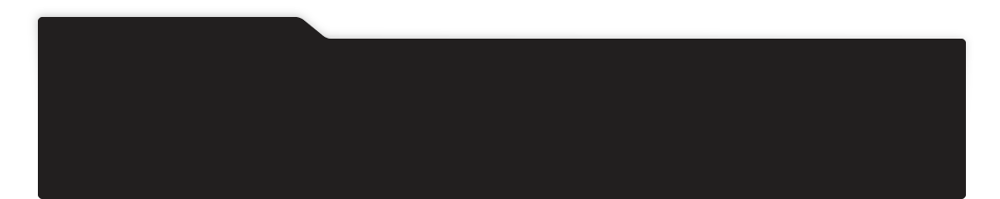
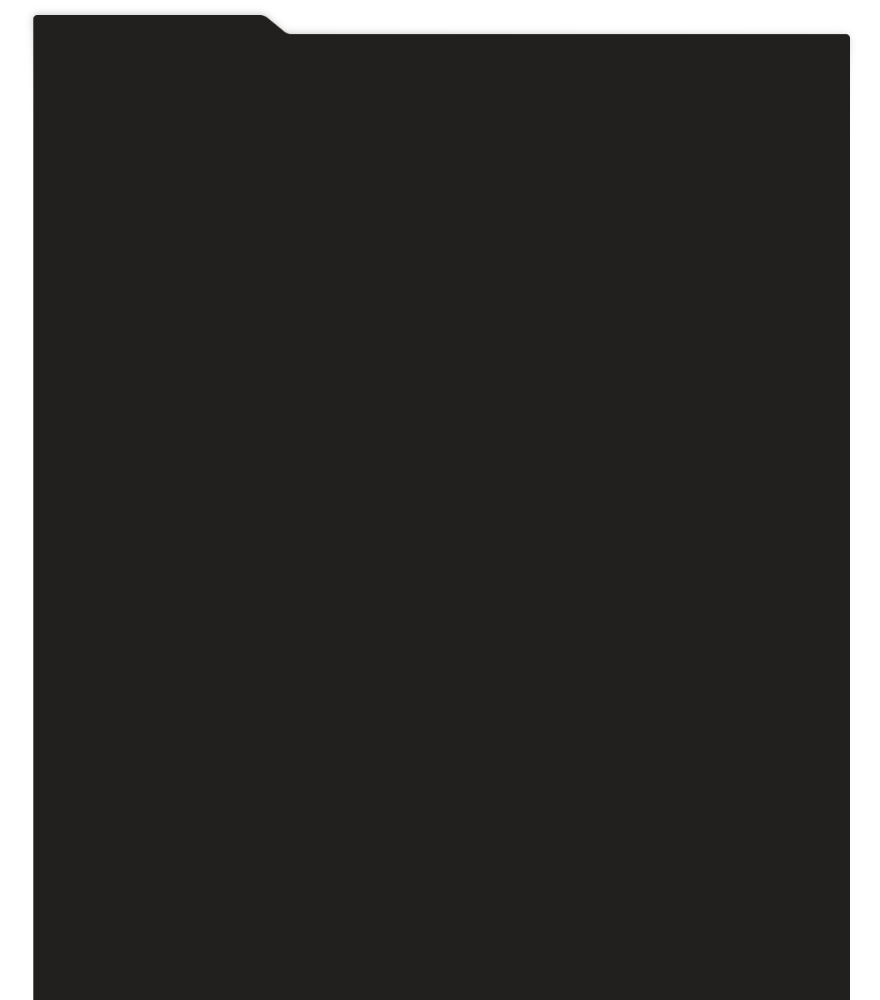
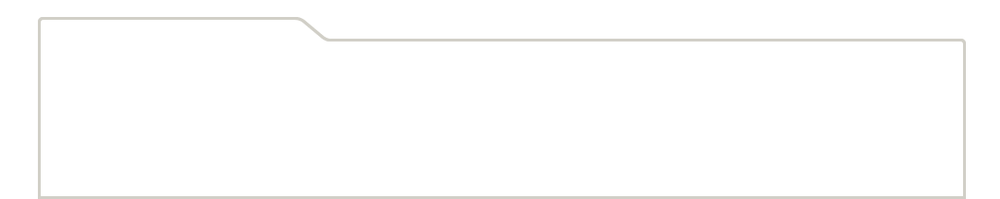
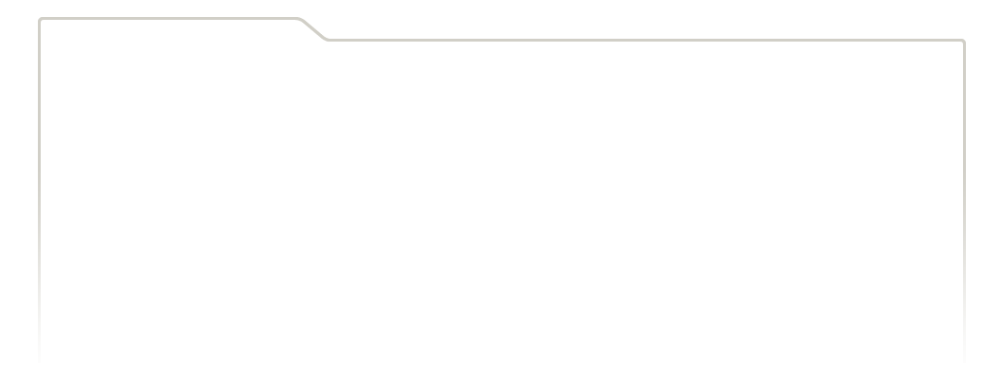
...
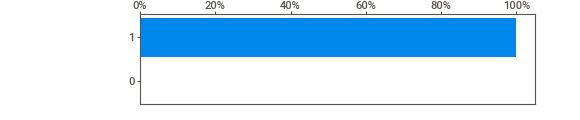
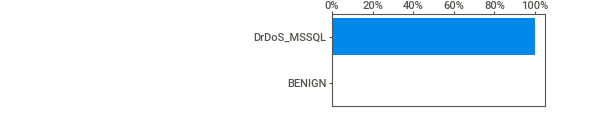
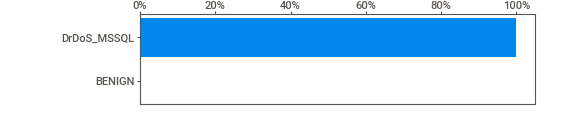
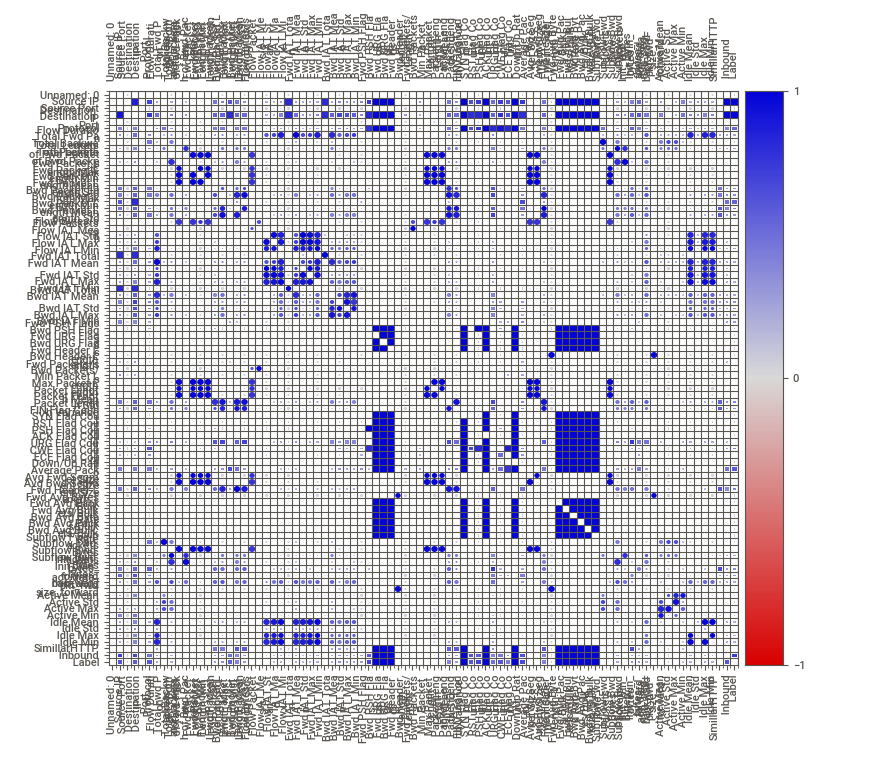
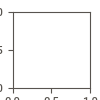

In [28]:
reportMSSQL = sv.analyze(MSSQLCopia)
reportMSSQL.show_notebook() 

In [29]:
reportMSSQL.show_html()

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [31]:
MSSQLCopia.to_csv('DrDoS_MSSQL_C.csv', sep=',')

## Reflection Attacks-TCP/UDP-NetBIOS

In [ ]:
NetBIOS = pd.read_csv("01-12/DrDos_NetBIOS.csv")

In [35]:
NetBIOSCopia= NetBIOS
NetBIOSCopia.isna().sum()

Unnamed: 0         0
Flow ID            0
 Source IP         0
 Source Port       0
 Destination IP    0
                  ..
 Idle Max          0
 Idle Min          0
SimillarHTTP       0
 Inbound           0
 Label             0
Length: 88, dtype: int64

In [36]:
NetBIOSCopia['SimillarHTTP'] = NetBIOSCopia["SimillarHTTP"].replace([0], "")

In [37]:
NetBIOSCopia = NetBIOSCopia.replace([np.inf, -np.inf], np.nan)

In [38]:
NetBIOSCopia=NetBIOSCopia.dropna()

In [39]:
NetBIOSCopia.to_csv('csv/DrDoS_NetBIOS_C.csv', sep=',')

## Reflection Attacks-TCP/UDP-NTP

In [46]:
NTP = pd.read_csv("01-12/DrDos_NTP.csv")

C:\Users\oscar\AppData\Local\Temp\ipykernel_10752\3176953525.py:1: DtypeWarning: Columns (85) have mixed types. Specify dtype option on import or set low_memory=False.
  NTP = pd.read_csv("01-12/DrDos_NTP.csv")


In [47]:
NTPCopia= NTP
NTPCopia.isna().sum()

Unnamed: 0         0
Flow ID            0
 Source IP         0
 Source Port       0
 Destination IP    0
                  ..
 Idle Max          0
 Idle Min          0
SimillarHTTP       0
 Inbound           0
 Label             0
Length: 88, dtype: int64

In [49]:
NTPCopia = NTPCopia.replace([np.inf, -np.inf], np.nan)

In [50]:
NTPCopia=NTPCopia.dropna()

In [51]:
NTPCopia.isna().values.any()

False

In [52]:
NTPCopia.to_csv('csv/DrDoS_NTP_C.csv', sep=',')

## Reflection Attacks-TCP/UDP-SNMP

In [53]:
SNMP = pd.read_csv("01-12/DrDos_SNMP.csv")

C:\Users\oscar\AppData\Local\Temp\ipykernel_10752\2880708961.py:1: DtypeWarning: Columns (85) have mixed types. Specify dtype option on import or set low_memory=False.
  SNMP = pd.read_csv("01-12/DrDos_SNMP.csv")


In [55]:
SNMPCopia= SNMP
SNMPCopia.isna().sum()

Unnamed: 0         0
Flow ID            0
 Source IP         0
 Source Port       0
 Destination IP    0
                  ..
 Idle Max          0
 Idle Min          0
SimillarHTTP       0
 Inbound           0
 Label             0
Length: 88, dtype: int64

In [56]:
SNMPCopia['SimillarHTTP'] = SNMPCopia["SimillarHTTP"].replace([0], "")

In [57]:
SNMPCopia = SNMPCopia.replace([np.inf, -np.inf], np.nan)

In [58]:
SNMPCopia=SNMPCopia.dropna()

In [59]:
SNMPCopia.isna().values.any()

False

In [60]:
SNMPCopia.to_csv('DrDoS_SNMP_C.csv', sep=',')

## Reflection Attacks-TCP-SSDP

In [61]:
SSDP = pd.read_csv("01-12/DrDos_SSDP.csv")

C:\Users\oscar\AppData\Local\Temp\ipykernel_10752\3448951648.py:1: DtypeWarning: Columns (85) have mixed types. Specify dtype option on import or set low_memory=False.
  SSDP = pd.read_csv("01-12/DrDos_SSDP.csv")


In [62]:
SSDPCopia= SSDP
SSDPCopia.isna().sum()

Unnamed: 0         0
Flow ID            0
 Source IP         0
 Source Port       0
 Destination IP    0
                  ..
 Idle Max          0
 Idle Min          0
SimillarHTTP       0
 Inbound           0
 Label             0
Length: 88, dtype: int64

In [63]:
SSDPCopia['SimillarHTTP'] = SSDPCopia["SimillarHTTP"].replace([0], "")

In [64]:
SSDPCopia = SSDPCopia.replace([np.inf, -np.inf], np.nan)

In [65]:
SSDPCopia=SSDPCopia.dropna()

In [66]:
SSDPCopia.isna().values.any()

False

In [67]:
SSDPCopia.to_csv('csv/DrDoS_SSDP_C.csv', sep=',')

## Reflection Attacks-TCP/UDP-UDP

In [68]:
UDP = pd.read_csv("01-12/DrDos_UDP.csv")

C:\Users\oscar\AppData\Local\Temp\ipykernel_10752\779412365.py:1: DtypeWarning: Columns (85) have mixed types. Specify dtype option on import or set low_memory=False.
  UDP = pd.read_csv("01-12/DrDos_UDP.csv")


In [70]:
UDPCopia= UDP
UDPCopia.isna().sum()

Unnamed: 0         0
Flow ID            0
 Source IP         0
 Source Port       0
 Destination IP    0
                  ..
 Idle Max          0
 Idle Min          0
SimillarHTTP       0
 Inbound           0
 Label             0
Length: 88, dtype: int64

In [71]:
UDPCopia['SimillarHTTP'] = UDPCopia["SimillarHTTP"].replace([0], "")

In [72]:
UDPCopia = UDPCopia.replace([np.inf, -np.inf], np.nan)

In [73]:
UDPCopia=UDPCopia.dropna()

In [74]:
UDPCopia.to_csv('DrDoS_UDP_C.csv', sep=',')

## Exploitation Attacksz-TCP-SYN

In [2]:
Syn = pd.read_csv("01-12/Syn.csv")

C:\Users\oscar\AppData\Local\Temp\ipykernel_7348\4066023639.py:1: DtypeWarning: Columns (85) have mixed types. Specify dtype option on import or set low_memory=False.
  Syn = pd.read_csv("01-12/Syn.csv")


In [3]:
SynCopia= Syn
SynCopia.isna().sum()

Unnamed: 0         0
Flow ID            0
 Source IP         0
 Source Port       0
 Destination IP    0
                  ..
 Idle Max          0
 Idle Min          0
SimillarHTTP       0
 Inbound           0
 Label             0
Length: 88, dtype: int64

In [4]:
SynCopia['SimillarHTTP'] = SynCopia["SimillarHTTP"].replace([0], "")

In [8]:
SynCopia = SynCopia.replace([np.inf, -np.inf], np.nan)

In [9]:
SynCopia=SynCopia.dropna()

In [10]:
SynCopia.isna().values.any()

False

In [11]:
SynCopia.to_csv('csv/Syn_C.csv', sep=',')

## Reflection Attacks-UDP-TFTP

In [2]:
TFTP = pd.read_csv("01-12/TFTP.csv",low_memory=False)

ParserError: Error tokenizing data. C error: out of memory

In [4]:
UDPLag = pd.read_csv("01-12/UDPLag.csv")

C:\Users\oscar\AppData\Local\Temp\ipykernel_13628\1225010846.py:1: DtypeWarning: Columns (85) have mixed types. Specify dtype option on import or set low_memory=False.
  UDPLag = pd.read_csv("01-12/UDPLag.csv")


In [5]:
UDPLagCopia= UDPLag
UDPLagCopia.isna().sum()

Unnamed: 0         0
Flow ID            0
 Source IP         0
 Source Port       0
 Destination IP    0
                  ..
 Idle Max          0
 Idle Min          0
SimillarHTTP       0
 Inbound           0
 Label             0
Length: 88, dtype: int64

In [6]:
UDPLagCopia['SimillarHTTP'] = UDPLagCopia["SimillarHTTP"].replace([0], "")

In [7]:
UDPLagCopia = UDPLagCopia.replace([np.inf, -np.inf], np.nan)

In [8]:
UDPLagCopia = UDPLagCopia.dropna()

In [9]:
UDPLagCopia.isna().values.any()

False

In [10]:
UDPLagCopia.to_csv('csv/UDPLag_C.csv', sep=',')